In [0]:
data_BASE_DIR = "dbfs:/mnt/mids-w261/"
display(dbutils.fs.ls(f"{data_BASE_DIR}"))

path,name,size,modificationTime
dbfs:/mnt/mids-w261/HW5/,HW5/,0,0
dbfs:/mnt/mids-w261/OTPW_12M/,OTPW_12M/,0,0
dbfs:/mnt/mids-w261/OTPW_1D_CSV/,OTPW_1D_CSV/,0,0
dbfs:/mnt/mids-w261/OTPW_36M/,OTPW_36M/,0,0
dbfs:/mnt/mids-w261/OTPW_3M/,OTPW_3M/,0,0
dbfs:/mnt/mids-w261/OTPW_3M_2015.csv,OTPW_3M_2015.csv,1500620247,1679772070000
dbfs:/mnt/mids-w261/OTPW_60M/,OTPW_60M/,0,0
dbfs:/mnt/mids-w261/airport-codes_csv.csv,airport-codes_csv.csv,6232459,1677623514000
dbfs:/mnt/mids-w261/datasets_final_project/,datasets_final_project/,0,0
dbfs:/mnt/mids-w261/datasets_final_project_2022/,datasets_final_project_2022/,0,0


In [0]:
data_BASE_DIR = "dbfs:/mnt/mids-w261/OTPW_12M/"
display(dbutils.fs.ls(f"{data_BASE_DIR}"))

path,name,size,modificationTime
dbfs:/mnt/mids-w261/OTPW_12M/OTPW_12M_2015.csv.gz,OTPW_12M_2015.csv.gz,1227614690,1679792632000
dbfs:/mnt/mids-w261/OTPW_12M/OTPW_12W_2015.csv.gz,OTPW_12W_2015.csv.gz,1227614690,1679792056000


In [0]:
# OPTW 12 months
from pyspark.sql.functions import col

df_OTPW_12 = spark.read.csv("dbfs:/mnt/mids-w261/OTPW_12M/OTPW_12M_2015.csv.gz", header=True, inferSchema=True)
#display(df_OTPW_12)

In [0]:
row_count = df_OTPW_12.count()
print(f"The DataFrame has {row_count} rows.")
print(len(df_OTPW_12.columns))

The DataFrame has 5811854 rows.
216


In [0]:
#Feature selection by observation in Phase1

feature_drop = [
                'QUARTER', 'DAY_OF_MONTH', 'OP_UNIQUE_CARRIER', 'WindEquipmentChangeDate',
                'ORIGIN_STATE_FIPS', 'ORIGIN_WAC', 'DEST_STATE_FIPS', 'DEST_WAC',
                'YEAR', 'MONTH', 'sched_depart_date_time_UTC', 'four_hours_prior_depart_UTC',
                'two_hours_prior_depart_UTC', 'DailyAverageDewPointTemperature', 'DailyAverageDryBulbTemperature', 'DailyAverageRelativeHumidity', 'FLIGHTS', 'sched_depart_date_time','DATE',
                'DailyAverageSeaLevelPressure', 'DailyAverageStationPressure', 'DailyAverageWetBulbTemperature', 'DailyAverageWindSpeed',
                'DailyCoolingDegreeDays', 'DailyDepartureFromNormalAverageTemperature', 'DailyHeatingDegreeDays', 'DailyMaximumDryBulbTemperature',
                'DailyMinimumDryBulbTemperature', 'DailyPeakWindDirection', 'DailyPeakWindSpeed', 'DailyPrecipitation', 'ARR_DELAY_NEW', 'FIRST_DEP_TIME', 'origin_station_id', 'Sunrise', 'Sunset',
                'DailySnowDepth', 'DailySnowfall', 'DailySustainedWindDirection', 'DailySustainedWindSpeed',
                'DailyWeather', 'MonthlyAverageRH', 'MonthlyDaysWithGT001Precip', 'MonthlyDaysWithGT010Precip',
                'MonthlyDaysWithGT32Temp', 'MonthlyDaysWithGT90Temp', 'MonthlyDaysWithLT0Temp', 'MonthlyDaysWithLT32Temp',
                'MonthlyDepartureFromNormalAverageTemperature', 'MonthlyDepartureFromNormalCoolingDegreeDays', 'MonthlyDepartureFromNormalHeatingDegreeDays', 'MonthlyDepartureFromNormalMaximumTemperature',
                'MonthlyDepartureFromNormalMinimumTemperature', 'MonthlyDepartureFromNormalPrecipitation', 'MonthlyDewpointTemperature', 'MonthlyGreatestPrecip',
                'MonthlyGreatestPrecipDate', 'MonthlyGreatestSnowDepth', 'MonthlyGreatestSnowDepthDate', 'MonthlyGreatestSnowfall',
                'MonthlyGreatestSnowfallDate', 'MonthlyMaxSeaLevelPressureValue', 'MonthlyMaxSeaLevelPressureValueDate', 'MonthlyMaxSeaLevelPressureValueTime',
                'MonthlyMaximumTemperature', 'MonthlyMeanTemperature', 'MonthlyMinSeaLevelPressureValue', 'MonthlyMinSeaLevelPressureValueDate',
                'MonthlyMinSeaLevelPressureValueTime', 'MonthlyMinimumTemperature', 'MonthlySeaLevelPressure', 'MonthlyStationPressure',
                'MonthlyTotalLiquidPrecipitation', 'MonthlyTotalSnowfall', 'MonthlyWetBulb', 'AWND',
                'CDSD', 'CLDD', 'DSNW', 'HDSD',
                'HTDD', 'ShortDurationEndDate005', 'ShortDurationEndDate010', 'ShortDurationEndDate015',
                'ShortDurationEndDate020', 'ShortDurationEndDate030', 'ShortDurationEndDate045', 'ShortDurationEndDate060',
                'ShortDurationEndDate080', 'ShortDurationEndDate100', 'ShortDurationEndDate120', 'ShortDurationEndDate150',
                'ShortDurationEndDate180', 'ShortDurationPrecipitationValue005', 'ShortDurationPrecipitationValue010', 'ShortDurationPrecipitationValue015',
                'ShortDurationPrecipitationValue020', 'ShortDurationPrecipitationValue030', 'ShortDurationPrecipitationValue045', 'ShortDurationPrecipitationValue060',
                'ShortDurationPrecipitationValue080', 'ShortDurationPrecipitationValue100', 'ShortDurationPrecipitationValue120', 'ShortDurationPrecipitationValue150',
                'ShortDurationPrecipitationValue180', 'BackupDirection', 'BackupDistance', 'BackupDistanceUnit',
                'BackupElements', 'BackupElevation', 'BackupEquipment', 'BackupLatitude',
                'BackupLongitude', 'BackupName', '_row_desc', 'ORIGIN_STATE_NM',
                'DEST_STATE_NM', 'DEP_DELAY_NEW', 'DEP_DELAY_GROUP', 'DEP_TIME_BLK',
                'ARR_DELAY_GROUP', 'ARR_TIME_BLK', 'CANCELLATION_CODE', 'DISTANCE_GROUP',
                'TOTAL_ADD_GTIME', 'LONGEST_ADD_GTIME', 'origin_station_name', 'dest_station_name',
                'dest_station_lon', 'dest_station_lat', 'origin_Station_lat', 'origin_station_lon',
                'REPORT_TYPE', 'SOURCE', 'NAME', 'LATITUDE',
                'LONGITUDE', 'ELEVATION', 'REM'
                ]
df_OTPW_12 = df_OTPW_12.drop(*feature_drop)

In [0]:
#Feature classification
df_OTPW_12.printSchema()

"""
1. Categorical features:
    TAIL_NUM, OP_CARRIER_AIRLINE_ID, OP_CARRIER, ORIGIN_AIRPORT_ID, ORIGIN_CITY_MARKET_ID, ORIGIN, ORIGIN_CITY_NAME, ORIGIN_STATE_ABR, DEST_AIRPORT_ID, DEST_CITY_MARKET_ID, DEST, DEST_CITY_NAME, DEST_STATE_ABR, CANCELLED, DIVERTED, origin_airport_name, origin_station_id, dest_iata_code, dest_icao, dest_station_id, dest_type, dest_region, STATION, Sunrise, Sunset, NormalsCoolingDegreeDay, NormalsHeatingDegreeDay

2. Numeric features:
    OP_CARRIER_FL_NUM, ORIGIN_AIRPORT_SEQ_ID, DEST_AIRPORT_SEQ_ID, DEP_DELAY, TAXI_OUT, WHEELS_OFF, WHEELS_ON
    TAXI_IN, DISTANCE, CARRIER_DELAY, WEATHER_DELAY, NAS_DELAY, SECURITY_DELAY, LATE_AIRCRAFT_DELAY, dest_station_dis,  HourlyAltimeterSetting, HourlyDewPointTemperature, HourlyDryBulbTemperature
    HourlyPrecipitation, HourlyPresentWeatherType, HourlyPressureChange, HourlyPressureTendency, HourlyRelativeHumidity, HourlySkyConditions, HourlySeaLevelPressure, HourlyStationPressure, HourlyVisibility, HourlyWetBulbTemperature, HourlyWindDirection, HourlyWindGustSpeed, HourlyWindSpeed, 
3. Ordinal features:
    DAY_OF_WEEK, dest_airport_lat, dest_airport_lon, OP_CARRIER_FL_NUM, ORIGIN_AIRPORT_SEQ_ID, DEST_AIRPORT_SEQ_ID
4. Time related features:
#Can be categorical, numeric or ordinal. It depends on the format.
5. Others: 
    REM

"""

root
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- FL_DATE: date (nullable = true)
 |-- OP_CARRIER_AIRLINE_ID: integer (nullable = true)
 |-- OP_CARRIER: string (nullable = true)
 |-- TAIL_NUM: string (nullable = true)
 |-- OP_CARRIER_FL_NUM: integer (nullable = true)
 |-- ORIGIN_AIRPORT_ID: integer (nullable = true)
 |-- ORIGIN_AIRPORT_SEQ_ID: integer (nullable = true)
 |-- ORIGIN_CITY_MARKET_ID: integer (nullable = true)
 |-- ORIGIN: string (nullable = true)
 |-- ORIGIN_CITY_NAME: string (nullable = true)
 |-- ORIGIN_STATE_ABR: string (nullable = true)
 |-- DEST_AIRPORT_ID: integer (nullable = true)
 |-- DEST_AIRPORT_SEQ_ID: integer (nullable = true)
 |-- DEST_CITY_MARKET_ID: integer (nullable = true)
 |-- DEST: string (nullable = true)
 |-- DEST_CITY_NAME: string (nullable = true)
 |-- DEST_STATE_ABR: string (nullable = true)
 |-- CRS_DEP_TIME: integer (nullable = true)
 |-- DEP_TIME: integer (nullable = true)
 |-- DEP_DELAY: double (nullable = true)
 |-- DEP_DEL15: double (nulla

'\n1. Categorical features:\n    TAIL_NUM, OP_CARRIER_AIRLINE_ID, OP_CARRIER, ORIGIN_AIRPORT_ID, ORIGIN_CITY_MARKET_ID, ORIGIN, ORIGIN_CITY_NAME, ORIGIN_STATE_ABR, DEST_AIRPORT_ID, DEST_CITY_MARKET_ID, DEST, DEST_CITY_NAME, DEST_STATE_ABR, CANCELLED, DIVERTED, origin_airport_name, origin_station_id, dest_iata_code, dest_icao, dest_station_id, dest_type, dest_region, STATION, Sunrise, Sunset, NormalsCoolingDegreeDay, NormalsHeatingDegreeDay\n\n2. Numeric features:\n    OP_CARRIER_FL_NUM, ORIGIN_AIRPORT_SEQ_ID, DEST_AIRPORT_SEQ_ID, DEP_DELAY, TAXI_OUT, WHEELS_OFF, WHEELS_ON\n    TAXI_IN, DISTANCE, CARRIER_DELAY, WEATHER_DELAY, NAS_DELAY, SECURITY_DELAY, LATE_AIRCRAFT_DELAY, dest_station_dis,  HourlyAltimeterSetting, HourlyDewPointTemperature, HourlyDryBulbTemperature\n    HourlyPrecipitation, HourlyPresentWeatherType, HourlyPressureChange, HourlyPressureTendency, HourlyRelativeHumidity, HourlySkyConditions, HourlySeaLevelPressure, HourlyStationPressure, HourlyVisibility, HourlyWetBulbTem

In [0]:
#Delete verlapping features
overlapping_features = [
                        'OP_CARRIER_AIRLINE_ID', 'ORIGIN_AIRPORT_ID', 'ORIGIN_CITY_MARKET_ID', 'ORIGIN_CITY_NAME', 'origin_airport_name', 'DEST_AIRPORT_ID', 'DEST_CITY_MARKET_ID',  'DEST_CITY_NAME', 'dest_region', 'dest_iata_code', 'NormalsCoolingDegreeDay', 'NormalsHeatingDegreeDay', 'ORIGIN', 'DEST', 'origin_iata_code', 'dest_airport_name', 
                        'origin_region','origin_airport_lat','origin_airport_lon', 'origin_station_dis', 'dest_airport_name', 'dest_airport_lat', 'dest_airport_lon', 'dest_station_dis'
                        ]

df_OTPW_12 = df_OTPW_12.drop(*overlapping_features)
#print(len(df_OTPW_3.columns)) 

#85 features -> 69 features

In [0]:
#Expand categorical features by one-hot encoding
from pyspark.ml.feature import StringIndexer
from pyspark.sql.functions import col, when

# Categorical features and their options
onehot_features = {
    'CANCELLED': [0, 1],
    'DIVERTED': [0, 1],
    'OP_CARRIER': ['UA', 'NK', 'AA', 'EV', 'B6', 'DL', 'OO', 'F9', 'US', 'MQ', 'HA', 'AS', 'VX', 'WN'],
    'dest_type': ['large_airport', 'medium_airport', 'small_airport'],
    'origin_type': ['large_airport', 'medium_airport', 'small_airport'],
    'ORIGIN_STATE_ABR': ['AZ', 'SC', 'LA', 'MN', 'NJ', 'OR', 'VA', 'RI', 'KY', 'WY', 'NH', 'MI', 'NV', 'WI', 'ID', 'CA', 'CT', 'NE', 'MT', 'NC', 'VT', 'MD', 'DE', 'MO', 'VI', 'IL', 'ME', 'WA', 'ND', 'MS', 'AL', 'IN', 'OH', 'TN', 'IA', 'NM', 'PA', 'SD', 'NY', 'TX', 'WV', 'GA', 'MA', 'KS', 'TT', 'FL', 'CO', 'AK', 'AR', 'OK', 'PR', 'UT', 'HI'],
    'DEST_STATE_ABR': ['AZ', 'SC', 'LA', 'MN', 'NJ', 'OR', 'VA', 'RI', 'KY', 'WY', 'NH', 'MI', 'NV', 'WI', 'ID', 'CA', 'CT', 'NE', 'MT', 'NC', 'VT', 'MD', 'DE', 'MO', 'VI', 'IL', 'ME', 'WA', 'ND', 'MS', 'AL', 'IN', 'OH', 'TN', 'IA', 'NM', 'PA', 'SD', 'NY', 'TX', 'WV', 'GA', 'MA', 'KS', 'TT', 'FL', 'CO', 'AK', 'AR', 'OK', 'PR', 'UT', 'HI']
}

# DataFrame to work with
df_encoded = df_OTPW_12

# Processing each feature
for feature, options in onehot_features.items():
    # StringIndexer for each feature
    indexer = StringIndexer(inputCol=feature, outputCol=feature + "_Index")
    df_encoded = indexer.fit(df_encoded).transform(df_encoded)
    
    # Creating binary columns for each option
    for option in options:
        option_name = str(option)  # Convert option to string in case it's numeric
        df_encoded = df_encoded.withColumn(f"{feature}_{option_name}", 
                                           when(col(feature) == option, 1).otherwise(0))

# Optionally, drop the original and indexed columns if not needed
for feature in onehot_features.keys():
    df_encoded = df_encoded.drop(feature, feature + "_Index")


#print(len(df_encoded.columns)) 
#display(df_encoded)


In [0]:
from pyspark.sql import functions as F
"""
origin_icao and dest_icao are both features with high cardinality (313 features)
    1. Grouping by states: 
        Replace the airport by state but it may lose some information. Airports in the same state under the same weather conditions may have different impacts on delay time.
    2. Hash table:
        Replace the airport by index grouped by state. For example, PABE, PANC, PABR are all in AK and can be hashed to 1,2,3. AK in range of 1 to 10 and CA in range of 11 to 20 and so on.
    3. Target encoding:
        Replace the airport by it's average target value. For example, average delay time in PABE is 5 mins, replace PABE by 5mins. This can only apply on training data in case of data leakage.

TAIL_NUM represents each airplane and it's also a high-cardinality feature (4562 features)
    1.Grouping by airplane companies
    2.Target encoding

Since the purpose of focusing on individual airport and airplane levels here is to point out if there is an airport whose infrastructure is old and may potentially cause delays, I prefer using target encoding.
"""

#drop STATION, dest_station_id and leave only origin_station_id since it was joined by origin_station_id
station_drop = ['STATION', 'dest_station_id']
df_encoded= df_encoded.drop(*station_drop)

#Target encoding: origin_icao
#for pipline, target encoding should be only on training not testing in case of data leakage

# Filter out cancelled flights and flights with null DEP_DELAY
df_encoded_filtered = df_encoded.filter(df_encoded["DEP_DELAY"].isNotNull())

# Calculate the mean DEP_DELAY for each origin_icao
mean_delay_per_origin = df_encoded_filtered.groupBy("origin_icao").agg(F.mean("DEP_DELAY").alias("origin_icao_delay"))

# Join the mean delay per origin to the original training and test dataframes
df_encoded_target = df_encoded.join(mean_delay_per_origin, ["origin_icao"], "left")
# df_encoded_target = df_encoded_target.drop("origin_icao")

#Target encoding: dest_icao

# Filter out cancelled flights and flights with null ARR_DELAY
df_encoded_filtered = df_encoded_target.filter(df_encoded["ARR_DELAY"].isNotNull())

# Calculate the mean DEP_DELAY for each dest_icao
mean_delay_per_dest = df_encoded_filtered.groupBy("dest_icao").agg(F.mean("ARR_DELAY").alias("dest_icao_delay"))

# Join the mean delay per origin to the original training and test dataframes
df_encoded_target = df_encoded_target.join(mean_delay_per_dest, ["dest_icao"], "left")
df_encoded_target = df_encoded_target.drop("dest_icao")

#Target encoding: TAIL_NUM
df_encoded_filtered = df_encoded_target.filter(df_encoded["DEP_DELAY"].isNotNull())

mean_delay_per_TAIL_NUM = df_encoded_filtered.groupBy("TAIL_NUM").agg(F.mean("DEP_DELAY").alias("TAIL_NUM_delay"))
df_encoded_target = df_encoded_target.join(mean_delay_per_TAIL_NUM, ["TAIL_NUM"], "left")
df_encoded_target = df_encoded_target.drop("TAIL_NUM")

#display(df_encoded_target)



In [0]:
from pyspark.sql.functions import col, expr
from pyspark.sql.functions import regexp_extract
from pyspark.sql.functions import mean, col, when, isnull
import math

#data cleansing: foramt, missing value...
#format
#ORIGIN_AIRPORT_SEQ_ID and DEST_AIRPORT_SEQ_ID. 1039705 -> 05
df_encoded_cleaned = df_encoded_target.withColumn("ORIGIN_AIRPORT_SEQ_ID", expr("cast(substring(cast(ORIGIN_AIRPORT_SEQ_ID as string), -2, 2) as int)"))

df_encoded_cleaned = df_encoded_cleaned.withColumn("DEST_AIRPORT_SEQ_ID", expr("cast(substring(cast(ORIGIN_AIRPORT_SEQ_ID as string), -2, 2) as int)"))

#HourlySkyConditions: BKN:07 7 CLR:08 20 means Broken Clouds at 700 feets and clear sky. Take only first condition BKN
df_encoded_cleaned = df_encoded_cleaned.withColumn("HourlySkyConditions", regexp_extract("HourlySkyConditions", "[A-Z]{3}", 0))

#HourlyPresentWeatherType: RA means rain, SN means snow where we have ||RA, +RA and RA and we only need RA
df_encoded_cleaned = df_encoded_cleaned.withColumn("HourlyPresentWeatherType", regexp_extract("HourlyPresentWeatherType", "[A-Z]{2}", 0))

#missing value
#fill null with mean :HourlyPressureChange, HourlyPressureTendency, HourlyWindGustSpeed, HourlyWindGustSpeed, HourlySeaLevelPressure
#by airport / weather station.
# Group by 'origin_icao' and calculate mean for each group
columns_to_fill = ['HourlyAltimeterSetting',  'HourlyDewPointTemperature', 'HourlyDryBulbTemperature', 'HourlyPrecipitation', 'HourlyPresentWeatherType', 'HourlyPressureChange', 'HourlyPressureTendency', 'HourlyRelativeHumidity', 'HourlySkyConditions', 'HourlySeaLevelPressure',
 'HourlyStationPressure', 'HourlyVisibility', 'HourlyWetBulbTemperature', 'HourlyWindDirection',
 'HourlyWindGustSpeed', 'HourlyWindSpeed']


mean_values_by_airport = df_encoded_cleaned.groupBy("origin_icao").agg(
    *[mean(col(c)).alias(f"{c}_mean") for c in columns_to_fill]
)

df_encoded_cleaned = df_encoded_cleaned.join(mean_values_by_airport, "origin_icao", "left")


# Filling null values with mean for each airport
for c in columns_to_fill:
    df_encoded_cleaned = df_encoded_cleaned.withColumn(c, when(isnull(col(c)), col(f"{c}_mean")).otherwise(col(c)))

# Drop the extra mean columns if they are no longer needed
for c in columns_to_fill:
    df_encoded_cleaned = df_encoded_cleaned.drop(f"{c}_mean")

#still got some null, some airport gets null average
mean_values = df_encoded_cleaned.select(
    [mean(col(c)).alias(c) for c in columns_to_fill]
).collect()[0]

for c in columns_to_fill:
    # Extract the mean value for the column
    mean_val = mean_values[c]

    # Check if mean_val is a valid number (not None or NaN)
    if mean_val is not None and not math.isnan(mean_val):
        # Fill nulls in the column with the mean value
        df_encoded_cleaned = df_encoded_cleaned.na.fill({c: float(mean_val)})


#fill null with zero: LATE_AIRCRAFT_DELAY, SECURITY_DELAY, NAS_DELAY, WEATHER_DELAY, CARRIER_DELAY
#As for DEP_TIME, DEP_DELAY, DEP_DEL15, ARR_TIME, ARR_DELAY, ARR_DEL15 we have CANCELLED to help out identifying them
columns_to_fill =  ['LATE_AIRCRAFT_DELAY', 'SECURITY_DELAY', 'NAS_DELAY', 'WEATHER_DELAY', 'CARRIER_DELAY',
                    'DEP_TIME', 'DEP_DELAY', 'DEP_DEL15', 'ARR_TIME', 'ARR_DELAY', 'ARR_DEL15', 'HourlyPresentWeatherType'
                    ]
df_encoded_cleaned = df_encoded_cleaned.na.fill(0, subset=columns_to_fill)
df_encoded_cleaned = df_encoded_cleaned.na.fill(0)
display(df_encoded_cleaned)


---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-2798664673128961>, line 11
      6 111
      8 #data cleansing: foramt, missing value...
      9 #format
     10 #ORIGIN_AIRPORT_SEQ_ID and DEST_AIRPORT_SEQ_ID. 1039705 -> 05
---> 11 df_encoded_cleaned = df_encoded_target.withColumn("ORIGIN_AIRPORT_SEQ_ID", expr("cast(substring(cast(ORIGIN_AIRPORT_SEQ_ID as string), -2, 2) as int)"))
     13 df_encoded_cleaned = df_encoded_cleaned.withColumn("DEST_AIRPORT_SEQ_ID", expr("cast(substring(cast(ORIGIN_AIRPORT_SEQ_ID as string), -2, 2) as int)"))
     15 #HourlySkyConditions: BKN:07 7 CLR:08 20 means Broken Clouds at 700 feets and clear sky. Take only first condition BKN

NameError: name 'df_encoded_target' is not defined

In [0]:
#RFM features
#The standard definition of bad weather in aviation
#1. horizontal winds or crosswinds in excess of 30-35 knots (about 34-40 mph) 
#2. visibility less than a certain threshold (which can vary but is often around half a mile or less) (0.8km?)
from pyspark.sql.functions import col, when, sum as pyspark_sum
from pyspark.sql.functions import col, when
from pyspark.sql.types import FloatType, IntegerType

# Cast columns to float
df_encoded_cleaned = df_encoded_cleaned.withColumn('HourlyVisibility', col('HourlyVisibility').cast(FloatType()))
df_encoded_cleaned = df_encoded_cleaned.withColumn('HourlyWindGustSpeed', col('HourlyWindGustSpeed').cast(FloatType()))
df_encoded_cleaned = df_encoded_cleaned.withColumn('HourlyWindSpeed', col('HourlyWindSpeed').cast(FloatType()))
df_encoded_cleaned = df_encoded_cleaned.withColumn('HourlySeaLevelPressure', col('HourlySeaLevelPressure').cast(FloatType()))
f_encoded_cleaned = df_encoded_cleaned.withColumn('DEP_DEL15', col('DEP_DEL15').cast(IntegerType()))

# Define bad weather condition with corrected logic
df_encoded_cleaned = df_encoded_cleaned.withColumn('bad_weather', 
                                                    when((col('HourlyVisibility') <= 0.8) | 
                                                         (col('HourlyWindGustSpeed') > 35) | 
                                                         (col('HourlyWindSpeed') > 35), 1).otherwise(0))

df_encoded_cleaned = df_encoded_cleaned.withColumn('bad_weather', col('bad_weather').cast(IntegerType()))

row_count = df_encoded_cleaned.count()

# Group by airport and calculate frequencies
freq_by_airport = df_encoded_cleaned.groupBy("origin_icao").agg(
    ((pyspark_sum('DEP_DEL15') / row_count)*100).alias('delay_frequency'),
    ((pyspark_sum('bad_weather') / row_count)*100).alias('bad_weather_frequency')
)

# Join the calculated frequencies back to the original DataFrame
df_encoded_cleaned_RMF = df_encoded_cleaned.join(freq_by_airport, "origin_icao", "left")

display(df_encoded_cleaned_RMF)

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-1537154891795090>, line 10
      7 from pyspark.sql.types import FloatType, IntegerType
      9 # Cast columns to float
---> 10 df_encoded_cleaned = df_encoded_cleaned.withColumn('HourlyVisibility', col('HourlyVisibility').cast(FloatType()))
     11 df_encoded_cleaned = df_encoded_cleaned.withColumn('HourlyWindGustSpeed', col('HourlyWindGustSpeed').cast(FloatType()))
     12 df_encoded_cleaned = df_encoded_cleaned.withColumn('HourlyWindSpeed', col('HourlyWindSpeed').cast(FloatType()))

NameError: name 'df_encoded_cleaned' is not defined

In [0]:
df_encoded_target_cleaned = df_encoded_cleaned_RMF

In [0]:
#options of HourlySkyConditions and HourlyPresentWeatherType
#Now they became categorical features

categorical_columns = ['HourlySkyConditions', 'HourlyPresentWeatherType']

for column in categorical_columns:
    unique_values = df_encoded_target_cleaned.select(column).distinct().collect()
    unique_values_list = [row[column] for row in unique_values]
    print(f"Unique values in {column}: {unique_values_list}")

Unique values in HourlySkyConditions: [None, 'OVC', 'FEW', '', 'BKN', 'SCT', 'CLR']
Unique values in HourlyPresentWeatherType: ['DZ', 'IC', 'FC', 'PL', 'RA', 'FG', None, 'BC', 'FZ', 'FU', 'MI', 'BL', 'BR', 'TS', 'UP', 'VC', 'SN', 'GS', 'HZ', '', 'SQ', 'DU', 'SH', 'PR', 'DR', 'SG']


In [0]:
#Treat new HourlySkyConditions and HourlySkyConditions as categorical features and can be expanded using one hot encoding

onehot_features = {
    'HourlySkyConditions': [None, 'OVC', 'FEW', '', 'BKN', 'SCT', 'CLR'],
    'HourlyPresentWeatherType': ['DZ', 'IC', 'PL', 'RA', 'FG', None, 'BC', 'FZ', 'FU', 'MI', 'BL', 'BR', 'DU', 'TS', 'UP', 'SH', 'VC', 'SN', 'GS', 'HZ', '', 'PR', 'SQ']
}

# DataFrame to work with
df_encoded_target_cleaned_encode2 = df_encoded_target_cleaned

# Processing each feature
for feature, options in onehot_features.items():
    # StringIndexer for each feature
    indexer = StringIndexer(inputCol=feature, outputCol=feature + "_Index")
    df_encoded_target_cleaned_encode2 = indexer.fit(df_encoded_target_cleaned_encode2).transform(df_encoded_target_cleaned_encode2)
    
    # Creating binary columns for each option
    for option in options:
        option_name = str(option)  # Convert option to string in case it's numeric
        df_encoded_target_cleaned_encode2 = df_encoded_target_cleaned_encode2.withColumn(f"{feature}_{option_name}", 
                                           when(col(feature) == option, 1).otherwise(0))

# Optionally, drop the original and indexed columns if not needed
for feature in onehot_features.keys():
    df_encoded_target_cleaned_encode2 = df_encoded_target_cleaned_encode2.drop(feature, feature + "_Index")

df_encoded_target_cleaned = df_encoded_target_cleaned_encode2
#print(len(df_encoded_target_cleaned.columns)) 
#display(df_encoded_target_cleaned)



In [0]:
#Transfer data type from string to double

from pyspark.sql.functions import col

columns_to_convert = [
    'HourlyAltimeterSetting',
    'HourlyDewPointTemperature',
    'HourlyDryBulbTemperature',
    'HourlyPrecipitation',
    'HourlyRelativeHumidity',
    'HourlySeaLevelPressure',
    'HourlyStationPressure',
    'HourlyVisibility',
    'HourlyWetBulbTemperature',
    'HourlyWindDirection',
    'HourlyWindGustSpeed',
    'HourlyWindSpeed',
    'HourlyPressureChange'
]

# Assuming your DataFrame is named df
for column in columns_to_convert:
    df_encoded_target_cleaned = df_encoded_target_cleaned.withColumn(column, col(column).cast('double'))

#display(df_encoded_target_cleaned)

In [0]:
#Transfer date type to ordinal data FL_DATE and WindEquipmentChangeDate
#calculate the difference in days from 2015-01-01
from pyspark.sql.functions import col, datediff, to_date, lit

epoch = lit('2015-01-01')
df_encoded_target_cleaned = df_encoded_target_cleaned.withColumn('FL_DATE_Ordinal', datediff('FL_DATE', epoch))
df_encoded_target_cleaned = df_encoded_target_cleaned.drop('FL_DATE')
display(df_encoded_target_cleaned)

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-2798664673128965>, line 6
      3 from pyspark.sql.functions import col, datediff, to_date, lit
      5 epoch = lit('2015-01-01')
----> 6 df_encoded_target_cleaned = df_encoded_target_cleaned.withColumn('FL_DATE_Ordinal', datediff('FL_DATE', epoch))
      7 df_encoded_target_cleaned = df_encoded_target_cleaned.drop('FL_DATE')
      8 display(df_encoded_target_cleaned)

NameError: name 'df_encoded_target_cleaned' is not defined

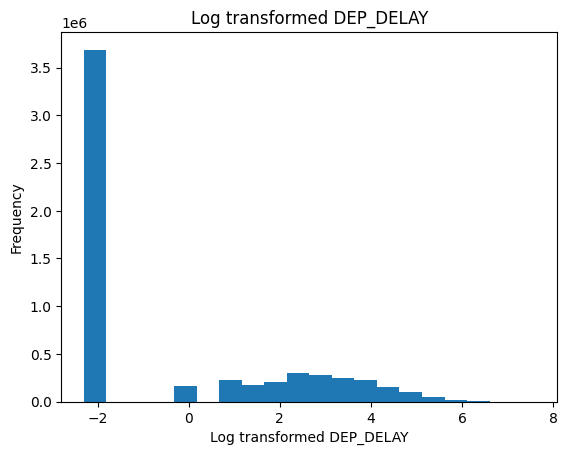

In [0]:
#DEP_DELAY may need to take log transform, if it's negative than 0
from pyspark.sql.functions import col, log, when
import matplotlib.pyplot as plt

# Adjusting DEP_DELAY such that negative values are set to zero
df_encoded_target_cleaned = df_encoded_target_cleaned.withColumn(
    'Adjusted_DEP_DELAY', 
    when(col('DEP_DELAY') < 0, 0).otherwise(col('DEP_DELAY'))
)

# Applying log transformation on the adjusted DEP_DELAY
df_encoded_target_cleaned = df_encoded_target_cleaned.withColumn(
    'Log_DEP_DELAY', 
    log(col('Adjusted_DEP_DELAY') + 0.1)
)

# Convert to Pandas DataFrame for plotting (for a small subset of data)
pdf = df_encoded_target_cleaned.select('Log_DEP_DELAY').toPandas()

# Plotting histograms for each selected feature
plt.hist(pdf, bins=20) 
plt.title('Log transformed DEP_DELAY')
plt.xlabel('Log transformed DEP_DELAY')
plt.ylabel('Frequency')
plt.show()

In [0]:
df_encoded_target_cleaned = df_encoded_target_cleaned.na.fill(0)
display(df_encoded_target_cleaned)

origin_icao,DAY_OF_WEEK,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_SEQ_ID,DEST_AIRPORT_SEQ_ID,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DEL15,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DEL15,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,CANCELLED_0,CANCELLED_1,DIVERTED_0,DIVERTED_1,OP_CARRIER_UA,OP_CARRIER_NK,OP_CARRIER_AA,OP_CARRIER_EV,OP_CARRIER_B6,OP_CARRIER_DL,OP_CARRIER_OO,OP_CARRIER_F9,OP_CARRIER_US,OP_CARRIER_MQ,OP_CARRIER_HA,OP_CARRIER_AS,OP_CARRIER_VX,OP_CARRIER_WN,dest_type_large_airport,dest_type_medium_airport,dest_type_small_airport,origin_type_large_airport,origin_type_medium_airport,origin_type_small_airport,ORIGIN_STATE_ABR_AZ,ORIGIN_STATE_ABR_SC,ORIGIN_STATE_ABR_LA,ORIGIN_STATE_ABR_MN,ORIGIN_STATE_ABR_NJ,ORIGIN_STATE_ABR_OR,ORIGIN_STATE_ABR_VA,ORIGIN_STATE_ABR_RI,ORIGIN_STATE_ABR_KY,ORIGIN_STATE_ABR_WY,ORIGIN_STATE_ABR_NH,ORIGIN_STATE_ABR_MI,ORIGIN_STATE_ABR_NV,ORIGIN_STATE_ABR_WI,ORIGIN_STATE_ABR_ID,ORIGIN_STATE_ABR_CA,ORIGIN_STATE_ABR_CT,ORIGIN_STATE_ABR_NE,ORIGIN_STATE_ABR_MT,ORIGIN_STATE_ABR_NC,ORIGIN_STATE_ABR_VT,ORIGIN_STATE_ABR_MD,ORIGIN_STATE_ABR_DE,ORIGIN_STATE_ABR_MO,ORIGIN_STATE_ABR_VI,ORIGIN_STATE_ABR_IL,ORIGIN_STATE_ABR_ME,ORIGIN_STATE_ABR_WA,ORIGIN_STATE_ABR_ND,ORIGIN_STATE_ABR_MS,ORIGIN_STATE_ABR_AL,ORIGIN_STATE_ABR_IN,ORIGIN_STATE_ABR_OH,ORIGIN_STATE_ABR_TN,ORIGIN_STATE_ABR_IA,ORIGIN_STATE_ABR_NM,ORIGIN_STATE_ABR_PA,ORIGIN_STATE_ABR_SD,ORIGIN_STATE_ABR_NY,ORIGIN_STATE_ABR_TX,ORIGIN_STATE_ABR_WV,ORIGIN_STATE_ABR_GA,ORIGIN_STATE_ABR_MA,ORIGIN_STATE_ABR_KS,ORIGIN_STATE_ABR_TT,ORIGIN_STATE_ABR_FL,ORIGIN_STATE_ABR_CO,ORIGIN_STATE_ABR_AK,ORIGIN_STATE_ABR_AR,ORIGIN_STATE_ABR_OK,ORIGIN_STATE_ABR_PR,ORIGIN_STATE_ABR_UT,ORIGIN_STATE_ABR_HI,DEST_STATE_ABR_AZ,DEST_STATE_ABR_SC,DEST_STATE_ABR_LA,DEST_STATE_ABR_MN,DEST_STATE_ABR_NJ,DEST_STATE_ABR_OR,DEST_STATE_ABR_VA,DEST_STATE_ABR_RI,DEST_STATE_ABR_KY,DEST_STATE_ABR_WY,DEST_STATE_ABR_NH,DEST_STATE_ABR_MI,DEST_STATE_ABR_NV,DEST_STATE_ABR_WI,DEST_STATE_ABR_ID,DEST_STATE_ABR_CA,DEST_STATE_ABR_CT,DEST_STATE_ABR_NE,DEST_STATE_ABR_MT,DEST_STATE_ABR_NC,DEST_STATE_ABR_VT,DEST_STATE_ABR_MD,DEST_STATE_ABR_DE,DEST_STATE_ABR_MO,DEST_STATE_ABR_VI,DEST_STATE_ABR_IL,DEST_STATE_ABR_ME,DEST_STATE_ABR_WA,DEST_STATE_ABR_ND,DEST_STATE_ABR_MS,DEST_STATE_ABR_AL,DEST_STATE_ABR_IN,DEST_STATE_ABR_OH,DEST_STATE_ABR_TN,DEST_STATE_ABR_IA,DEST_STATE_ABR_NM,DEST_STATE_ABR_PA,DEST_STATE_ABR_SD,DEST_STATE_ABR_NY,DEST_STATE_ABR_TX,DEST_STATE_ABR_WV,DEST_STATE_ABR_GA,DEST_STATE_ABR_MA,DEST_STATE_ABR_KS,DEST_STATE_ABR_TT,DEST_STATE_ABR_FL,DEST_STATE_ABR_CO,DEST_STATE_ABR_AK,DEST_STATE_ABR_AR,DEST_STATE_ABR_OK,DEST_STATE_ABR_PR,DEST_STATE_ABR_UT,DEST_STATE_ABR_HI,origin_icao_delay,dest_icao_delay,TAIL_NUM_delay,bad_weather,delay_frequency,bad_weather_frequency,HourlySkyConditions_None,HourlySkyConditions_OVC,HourlySkyConditions_FEW,HourlySkyConditions_,HourlySkyConditions_BKN,HourlySkyConditions_SCT,HourlySkyConditions_CLR,HourlyPresentWeatherType_DZ,HourlyPresentWeatherType_IC,HourlyPresentWeatherType_PL,HourlyPresentWeatherType_RA,HourlyPresentWeatherType_FG,HourlyPresentWeatherType_None,HourlyPresentWeatherType_BC,HourlyPresentWeatherType_FZ,HourlyPresentWeatherType_FU,HourlyPresentWeatherType_MI,HourlyPresentWeatherType_BL,HourlyPresentWeatherType_BR,HourlyPresentWeatherType_DU,HourlyPresentWeatherType_TS,HourlyPresentWeatherType_UP,HourlyPresentWeatherType_SH,HourlyPresentWeatherType_VC,HourlyPresentWeatherType_SN,HourlyPresentWeatherType_GS,HourlyPresentWeatherType_HZ,HourlyPresentWeatherType_,HourlyPresentWeatherType_PR,HourlyPresentWeatherType_SQ,FL_DATE_Ordinal,Adjusted_DEP_DELAY,Log_DEP_DE

In [0]:
#Feature engineering and refinement
    # At least one time-based feature, e.g., recency, frequency, monetary (RFM) --bad_weather_frequency, delay_frequency
    # Graph-based features (e.g., a topic-based PageRank by airline) --top20_busiest_airports
    # Event-based features (holidays, SuperBowl) -- Is_Holiday_Period
    # Airport maintenance -- delay_frequency by airport?
    # Natural disasters -- bad_weather_frequency?
    # Airline Reputation --delay_frequency -- as one-hot encoded OP_CARRIER_XX

#is_Holiday_Period

from pyspark.sql import functions as F

thanksgiving_range = (323, 331) # November 19 to 27
christmas_range = (354, 362) # December 20 to 28
new_years_range = (359, 6) # December 25 to January 6
spring_break_range = (70, 78) # March 11 to 19
memorial_day_range = (145, 153) # May 25 to June 2
july_fourth_range = (181, 189) # June 30 to July 8
labor_day_range = (243, 251) # August 31 to September 8
summer_day_range = (192, 200) # July 11 to 19

# Create a new column 'Is_Holiday_Period' based on these intervals
df_encoded_target_cleaned = df_encoded_target_cleaned.withColumn(
    "is_holiday_period", 
    F.when(
        (F.col("FL_DATE_Ordinal").between(*thanksgiving_range)) |
        (F.col("FL_DATE_Ordinal").between(*christmas_range)) |
        (F.col("FL_DATE_Ordinal").between(*new_years_range)) |
        (F.col("FL_DATE_Ordinal").between(*spring_break_range)) |
        (F.col("FL_DATE_Ordinal").between(*memorial_day_range)) |
        (F.col("FL_DATE_Ordinal").between(*july_fourth_range)) |
        (F.col("FL_DATE_Ordinal").between(*labor_day_range)) |
        (F.col("FL_DATE_Ordinal").between(*summer_day_range)), 
        1
    ).otherwise(0)
)

#top 20 busiest airports by the pagerank algorithm 
top_20_airports = ['KATL', 'KDFW', 'KDEN', 'KORD', 'KLAX', 'KJFK', 'KLAS', 'KMCO', 
                   'KMIA', 'KCLT', 'KSEA', 'KPHX', 'KEWR', 'KSFO', 'KIAH', 'KBOS', 
                   'KFLL', 'KMSP', 'KLGA', 'KDTW']

df_encoded_target_cleaned = df_encoded_target_cleaned.withColumn(
    'top20_busiest_airports',
    F.when(F.col('origin_icao').isin(top_20_airports), 
           F.when(F.col('origin_icao') == 'KATL', 1)
            .when(F.col('origin_icao') == 'KDFW', 2)
            .when(F.col('origin_icao') == 'KDEN', 3)
            .when(F.col('origin_icao') == 'KORD', 4)
            .when(F.col('origin_icao') == 'KLAX', 5)
            .when(F.col('origin_icao') == 'KJFK', 6)
            .when(F.col('origin_icao') == 'KLAS', 7)
            .when(F.col('origin_icao') == 'KMCO', 8)
            .when(F.col('origin_icao') == 'KMIA', 9)
            .when(F.col('origin_icao') == 'KCLT', 10)
            .when(F.col('origin_icao') == 'KSEA', 11)
            .when(F.col('origin_icao') == 'KPHX', 12)
            .when(F.col('origin_icao') == 'KEWR', 13)
            .when(F.col('origin_icao') == 'KSFO', 14)
            .when(F.col('origin_icao') == 'KIAH', 15)
            .when(F.col('origin_icao') == 'KBOS', 16)
            .when(F.col('origin_icao') == 'KFLL', 17)
            .when(F.col('origin_icao') == 'KMSP', 18)
            .when(F.col('origin_icao') == 'KLGA', 19)
            .when(F.col('origin_icao') == 'KDTW', 20))
    .otherwise(21)
)

display(df_encoded_target_cleaned)
#updated to 12M, and pipeline


---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-1346418319516049>, line 23
     20 summer_day_range = (192, 200) # July 11 to 19
     22 # Create a new column 'Is_Holiday_Period' based on these intervals
---> 23 df_encoded_target_cleaned = df_encoded_target_cleaned.withColumn(
     24     "is_holiday_period", 
     25     F.when(
     26         (F.col("FL_DATE_Ordinal").between(*thanksgiving_range)) |
     27         (F.col("FL_DATE_Ordinal").between(*christmas_range)) |
     28         (F.col("FL_DATE_Ordinal").between(*new_years_range)) |
     29         (F.col("FL_DATE_Ordinal").between(*spring_break_range)) |
     30         (F.col("FL_DATE_Ordinal").between(*memorial_day_range)) |
     31         (F.col("FL_DATE_Ordinal").between(*july_fourth_range)) |
     32         (F.col("FL_DATE_Ordinal").between(*labor_day_range)) |
     33         (F.col("FL_DATE_Ordinal").

In [0]:
#Save the data to blob storage with parquet format

# The following blob storage is accessible to team members only (read and write)
# access key is valid til TTL
# after that you will need to create a new SAS key and authenticate access again via DataBrick command line
blob_container  = "w261team61"       # The name of your container created in https://portal.azure.com
storage_account = "w261finalteam61"  # The name of your Storage account created in https://portal.azure.com
secret_scope    = "team61"           # The name of the scope created in your local computer using the Databricks CLI
secret_key      = "2kmGIIYhBq3H196B9mWICjnspOYsEINqM6yrzGG1agnA5ZwjIAdSSayXcrZYXf9zUUarVptUTS74+AStkH6Ylg=="             # The name of the secret key created in your local computer using the Databricks CLI
team_blob_url   = f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net"  #points to the root of your team storage bucket


# the 261 course blob storage is mounted here.
mids261_mount_path      = "/mnt/mids-w261"

# SAS Token: Grant the team limited access to Azure Storage resources
spark.conf.set(
  f"fs.azure.sas.{blob_container}.{storage_account}.blob.core.windows.net",
  dbutils.secrets.get(scope = secret_scope, key = secret_key)
)

# The following can write the dataframe to the team's Cloud Storage  
# Navigate back to your Storage account in https://portal.azure.com, to inspect the partitions/files.
df_encoded_target_cleaned.write.mode('overwrite').parquet(f"{team_blob_url}/EDA_OPTW_12M")

# see what's in the blob storage root folder 
display(dbutils.fs.ls(f"{team_blob_url}"))



path,name,size,modificationTime
wasbs://w261team61@w261finalteam61.blob.core.windows.net/EDA_OPTW_12M/,EDA_OPTW_12M/,0,1702106249000
wasbs://w261team61@w261finalteam61.blob.core.windows.net/EDA_OPTW_3M/,EDA_OPTW_3M/,0,1702102221000
wasbs://w261team61@w261finalteam61.blob.core.windows.net/EDA_OPTW_60M/,EDA_OPTW_60M/,0,1702081520000
wasbs://w261team61@w261finalteam61.blob.core.windows.net/TP/,TP/,0,1698747699000


In [0]:
df_OPTW_12M = spark.read.parquet(f"{team_blob_url}/EDA_OPTW_12M")
display(df_OPTW_12M)

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-2798664673128975>, line 1
----> 1 df_OPTW_12M = spark.read.parquet(f"{team_blob_url}/EDA_OPTW_12M")
      2 display(df_OPTW_12M)

NameError: name 'team_blob_url' is not defined

In [0]:
row_count = df_OPTW_12M.count()
print(f"The DataFrame has {row_count} rows.")

print(len(df_OPTW_12M.columns))

The DataFrame has 5811854 rows.
211


In [0]:
#PCA
from pyspark.ml.feature import PCA, StandardScaler, VectorAssembler
from pyspark.ml.linalg import Vectors

numeric_ordinal_features = ['DAY_OF_WEEK', 'OP_CARRIER_FL_NUM', 'ORIGIN_AIRPORT_SEQ_ID',
                            'CRS_DEP_TIME', 'DISTANCE', 'HourlyAltimeterSetting', 'HourlyDewPointTemperature', 'HourlyDryBulbTemperature', 'HourlyPrecipitation', 'HourlyPressureChange', 'HourlyPressureTendency', 'HourlyRelativeHumidity', 'HourlySeaLevelPressure', 'HourlyStationPressure', 'HourlyVisibility', 'HourlyWetBulbTemperature', 'HourlyWindDirection', 'HourlyWindGustSpeed', 'HourlyWindSpeed','delay_frequency','bad_weather_frequency','TAIL_NUM_delay', 'FL_DATE_Ordinal','top20_busiest_airports'
                            ]

one_hot_features = [
                    'is_holiday_period', 'OP_CARRIER_UA', 'OP_CARRIER_NK', 'OP_CARRIER_AA', 'OP_CARRIER_EV', 'OP_CARRIER_B6', 'OP_CARRIER_DL', 'OP_CARRIER_OO', 
                    'OP_CARRIER_F9', 'OP_CARRIER_US', 'OP_CARRIER_MQ', 'OP_CARRIER_HA', 'OP_CARRIER_AS',
                    'OP_CARRIER_VX', 'OP_CARRIER_WN', 'origin_type_large_airport', 'origin_type_medium_airport', 'origin_type_small_airport', 'ORIGIN_STATE_ABR_AZ', 'ORIGIN_STATE_ABR_SC', 'ORIGIN_STATE_ABR_LA',
                    'ORIGIN_STATE_ABR_MN', 'ORIGIN_STATE_ABR_NJ', 'ORIGIN_STATE_ABR_OR', 'ORIGIN_STATE_ABR_VA',
                    'ORIGIN_STATE_ABR_RI', 'ORIGIN_STATE_ABR_KY', 'ORIGIN_STATE_ABR_WY', 'ORIGIN_STATE_ABR_NH',
                    'ORIGIN_STATE_ABR_MI', 'ORIGIN_STATE_ABR_NV', 'ORIGIN_STATE_ABR_WI', 'ORIGIN_STATE_ABR_ID',
                    'ORIGIN_STATE_ABR_CA', 'ORIGIN_STATE_ABR_CT', 'ORIGIN_STATE_ABR_NE', 'ORIGIN_STATE_ABR_MT',
                    'ORIGIN_STATE_ABR_NC', 'ORIGIN_STATE_ABR_VT', 'ORIGIN_STATE_ABR_MD', 'ORIGIN_STATE_ABR_DE',
                    'ORIGIN_STATE_ABR_MO', 'ORIGIN_STATE_ABR_VI', 'ORIGIN_STATE_ABR_IL', 'ORIGIN_STATE_ABR_ME',
                    'ORIGIN_STATE_ABR_WA', 'ORIGIN_STATE_ABR_ND', 'ORIGIN_STATE_ABR_MS', 'ORIGIN_STATE_ABR_AL',
                    'ORIGIN_STATE_ABR_IN', 'ORIGIN_STATE_ABR_OH', 'ORIGIN_STATE_ABR_TN', 'ORIGIN_STATE_ABR_IA',
                    'ORIGIN_STATE_ABR_NM', 'ORIGIN_STATE_ABR_PA', 'ORIGIN_STATE_ABR_SD', 'ORIGIN_STATE_ABR_NY',
                    'ORIGIN_STATE_ABR_TX', 'ORIGIN_STATE_ABR_WV', 'ORIGIN_STATE_ABR_GA', 'ORIGIN_STATE_ABR_MA',
                    'ORIGIN_STATE_ABR_KS', 'ORIGIN_STATE_ABR_TT', 'ORIGIN_STATE_ABR_FL', 'ORIGIN_STATE_ABR_CO',
                    'ORIGIN_STATE_ABR_AK', 'ORIGIN_STATE_ABR_AR', 'ORIGIN_STATE_ABR_OK', 'ORIGIN_STATE_ABR_PR',
                    'ORIGIN_STATE_ABR_UT', 'ORIGIN_STATE_ABR_HI', 'DEST_STATE_ABR_AZ', 'DEST_STATE_ABR_SC',
                    'DEST_STATE_ABR_LA', 'DEST_STATE_ABR_MN', 'DEST_STATE_ABR_NJ', 'DEST_STATE_ABR_OR',
                    'DEST_STATE_ABR_VA', 'DEST_STATE_ABR_RI', 'DEST_STATE_ABR_KY', 'DEST_STATE_ABR_WY',
                    'DEST_STATE_ABR_NH', 'DEST_STATE_ABR_MI', 'DEST_STATE_ABR_NV', 'DEST_STATE_ABR_WI',
                    'DEST_STATE_ABR_ID', 'DEST_STATE_ABR_CA', 'DEST_STATE_ABR_CT', 'DEST_STATE_ABR_NE', 
                    'DEST_STATE_ABR_MT', 'DEST_STATE_ABR_NC', 'DEST_STATE_ABR_VT', 'DEST_STATE_ABR_MD',
                    'DEST_STATE_ABR_DE', 'DEST_STATE_ABR_MO', 'DEST_STATE_ABR_VI', 'DEST_STATE_ABR_IL',
                    'DEST_STATE_ABR_ME', 'DEST_STATE_ABR_WA', 'DEST_STATE_ABR_ND', 'DEST_STATE_ABR_MS',
                    'DEST_STATE_ABR_AL', 'DEST_STATE_ABR_IN', 'DEST_STATE_ABR_OH', 'DEST_STATE_ABR_TN',
                    'DEST_STATE_ABR_IA', 'DEST_STATE_ABR_NM', 'DEST_STATE_ABR_PA', 'DEST_STATE_ABR_SD',
                    'DEST_STATE_ABR_NY', 'DEST_STATE_ABR_TX', 'DEST_STATE_ABR_WV', 'DEST_STATE_ABR_GA',
                    'DEST_STATE_ABR_MA', 'DEST_STATE_ABR_KS', 'DEST_STATE_ABR_TT', 'DEST_STATE_ABR_FL',
                    'DEST_STATE_ABR_CO', 'DEST_STATE_ABR_AK', 'DEST_STATE_ABR_AR', 'DEST_STATE_ABR_OK',
                    'DEST_STATE_ABR_PR', 'DEST_STATE_ABR_UT', 'DEST_STATE_ABR_HI', 'HourlySkyConditions_None', 'HourlySkyConditions_OVC',
                    'HourlySkyConditions_FEW', 'HourlySkyConditions_', 'HourlySkyConditions_BKN', 'HourlySkyConditions_SCT', 'HourlySkyConditions_CLR', 'HourlyPresentWeatherType_DZ', 'HourlyPresentWeatherType_IC',
                    'HourlyPresentWeatherType_PL', 'HourlyPresentWeatherType_RA', 'HourlyPresentWeatherType_FG',
                    'HourlyPresentWeatherType_None', 'HourlyPresentWeatherType_BC', 'HourlyPresentWeatherType_FZ', 'HourlyPresentWeatherType_FU', 'HourlyPresentWeatherType_MI', 'HourlyPresentWeatherType_BL',
                    'HourlyPresentWeatherType_BR', 'HourlyPresentWeatherType_DU', 'HourlyPresentWeatherType_TS',
                    'HourlyPresentWeatherType_UP', 'HourlyPresentWeatherType_SH', 'HourlyPresentWeatherType_VC', 'HourlyPresentWeatherType_SN', 'HourlyPresentWeatherType_GS', 'HourlyPresentWeatherType_HZ',
                    'HourlyPresentWeatherType_', 'HourlyPresentWeatherType_PR', 'HourlyPresentWeatherType_SQ',
                    ]


#put nmeric features into a vector.
numeric_assembler = VectorAssembler(inputCols=numeric_ordinal_features, outputCol="numeric_vector")
numeric_vectorized = numeric_assembler.transform(df_encoded_target_cleaned)
#scale up.
scaler = StandardScaler(inputCol="numeric_vector", outputCol="scaled_numeric_vector")
scaled_data = scaler.fit(numeric_vectorized).transform(numeric_vectorized)

#add with one-hot encoded  features
final_assembler = VectorAssembler(inputCols=["scaled_numeric_vector"] + one_hot_features, outputCol="final_features_vector")
final_vectorized_data = final_assembler.transform(scaled_data)


pca = PCA(k=12, inputCol="final_features_vector", outputCol="pcaFeatures")
pca_model = pca.fit(final_vectorized_data)
pca_result = pca_model.transform(final_vectorized_data)

# Display the result
display(pca_result)



---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-1346418319518560>, line 50
     48 #put nmeric features into a vector.
     49 numeric_assembler = VectorAssembler(inputCols=numeric_ordinal_features, outputCol="numeric_vector")
---> 50 numeric_vectorized = numeric_assembler.transform(df_encoded_target_cleaned)
     51 #scale up.
     52 scaler = StandardScaler(inputCol="numeric_vector", outputCol="scaled_numeric_vector")

NameError: name 'df_encoded_target_cleaned' is not defined

In [0]:
from pyspark.sql.functions import col, udf
from pyspark.sql.types import DoubleType
from pyspark.ml.linalg import DenseVector

# UDF to extract elements from a vector
def extract_vector_element(vec, element):
    try:
        return float(vec[element])
    except KeyError:
        return None

extract_element_udf = udf(extract_vector_element, DoubleType())

# Create new columns for each element in the vector
pca_extracted_df = pca_result
for i in range(12):  # 12 elements in the vector
    pca_extracted_df = pca_extracted_df.withColumn(f"pcaFeature_{i+1}", extract_element_udf(col("pcaFeatures"), lit(i)))

# Select only the extracted features
# pca_extracted_df = pca_extracted_df.select([col(f"pcaFeature_{i+1}") for i in range(12)])
display(pca_extracted_df)

origin_icao,DAY_OF_WEEK,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_SEQ_ID,DEST_AIRPORT_SEQ_ID,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DEL15,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DEL15,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,CANCELLED_0,CANCELLED_1,DIVERTED_0,DIVERTED_1,OP_CARRIER_UA,OP_CARRIER_NK,OP_CARRIER_AA,OP_CARRIER_EV,OP_CARRIER_B6,OP_CARRIER_DL,OP_CARRIER_OO,OP_CARRIER_F9,OP_CARRIER_US,OP_CARRIER_MQ,OP_CARRIER_HA,OP_CARRIER_AS,OP_CARRIER_VX,OP_CARRIER_WN,dest_type_large_airport,dest_type_medium_airport,dest_type_small_airport,origin_type_large_airport,origin_type_medium_airport,origin_type_small_airport,ORIGIN_STATE_ABR_AZ,ORIGIN_STATE_ABR_SC,ORIGIN_STATE_ABR_LA,ORIGIN_STATE_ABR_MN,ORIGIN_STATE_ABR_NJ,ORIGIN_STATE_ABR_OR,ORIGIN_STATE_ABR_VA,ORIGIN_STATE_ABR_RI,ORIGIN_STATE_ABR_KY,ORIGIN_STATE_ABR_WY,ORIGIN_STATE_ABR_NH,ORIGIN_STATE_ABR_MI,ORIGIN_STATE_ABR_NV,ORIGIN_STATE_ABR_WI,ORIGIN_STATE_ABR_ID,ORIGIN_STATE_ABR_CA,ORIGIN_STATE_ABR_CT,ORIGIN_STATE_ABR_NE,ORIGIN_STATE_ABR_MT,ORIGIN_STATE_ABR_NC,ORIGIN_STATE_ABR_VT,ORIGIN_STATE_ABR_MD,ORIGIN_STATE_ABR_DE,ORIGIN_STATE_ABR_MO,ORIGIN_STATE_ABR_VI,ORIGIN_STATE_ABR_IL,ORIGIN_STATE_ABR_ME,ORIGIN_STATE_ABR_WA,ORIGIN_STATE_ABR_ND,ORIGIN_STATE_ABR_MS,ORIGIN_STATE_ABR_AL,ORIGIN_STATE_ABR_IN,ORIGIN_STATE_ABR_OH,ORIGIN_STATE_ABR_TN,ORIGIN_STATE_ABR_IA,ORIGIN_STATE_ABR_NM,ORIGIN_STATE_ABR_PA,ORIGIN_STATE_ABR_SD,ORIGIN_STATE_ABR_NY,ORIGIN_STATE_ABR_TX,ORIGIN_STATE_ABR_WV,ORIGIN_STATE_ABR_GA,ORIGIN_STATE_ABR_MA,ORIGIN_STATE_ABR_KS,ORIGIN_STATE_ABR_TT,ORIGIN_STATE_ABR_FL,ORIGIN_STATE_ABR_CO,ORIGIN_STATE_ABR_AK,ORIGIN_STATE_ABR_AR,ORIGIN_STATE_ABR_OK,ORIGIN_STATE_ABR_PR,ORIGIN_STATE_ABR_UT,ORIGIN_STATE_ABR_HI,DEST_STATE_ABR_AZ,DEST_STATE_ABR_SC,DEST_STATE_ABR_LA,DEST_STATE_ABR_MN,DEST_STATE_ABR_NJ,DEST_STATE_ABR_OR,DEST_STATE_ABR_VA,DEST_STATE_ABR_RI,DEST_STATE_ABR_KY,DEST_STATE_ABR_WY,DEST_STATE_ABR_NH,DEST_STATE_ABR_MI,DEST_STATE_ABR_NV,DEST_STATE_ABR_WI,DEST_STATE_ABR_ID,DEST_STATE_ABR_CA,DEST_STATE_ABR_CT,DEST_STATE_ABR_NE,DEST_STATE_ABR_MT,DEST_STATE_ABR_NC,DEST_STATE_ABR_VT,DEST_STATE_ABR_MD,DEST_STATE_ABR_DE,DEST_STATE_ABR_MO,DEST_STATE_ABR_VI,DEST_STATE_ABR_IL,DEST_STATE_ABR_ME,DEST_STATE_ABR_WA,DEST_STATE_ABR_ND,DEST_STATE_ABR_MS,DEST_STATE_ABR_AL,DEST_STATE_ABR_IN,DEST_STATE_ABR_OH,DEST_STATE_ABR_TN,DEST_STATE_ABR_IA,DEST_STATE_ABR_NM,DEST_STATE_ABR_PA,DEST_STATE_ABR_SD,DEST_STATE_ABR_NY,DEST_STATE_ABR_TX,DEST_STATE_ABR_WV,DEST_STATE_ABR_GA,DEST_STATE_ABR_MA,DEST_STATE_ABR_KS,DEST_STATE_ABR_TT,DEST_STATE_ABR_FL,DEST_STATE_ABR_CO,DEST_STATE_ABR_AK,DEST_STATE_ABR_AR,DEST_STATE_ABR_OK,DEST_STATE_ABR_PR,DEST_STATE_ABR_UT,DEST_STATE_ABR_HI,origin_icao_delay,dest_icao_delay,TAIL_NUM_delay,bad_weather,delay_frequency,bad_weather_frequency,HourlySkyConditions_None,HourlySkyConditions_OVC,HourlySkyConditions_FEW,HourlySkyConditions_,HourlySkyConditions_BKN,HourlySkyConditions_SCT,HourlySkyConditions_CLR,HourlyPresentWeatherType_DZ,HourlyPresentWeatherType_IC,HourlyPresentWeatherType_PL,HourlyPresentWeatherType_RA,HourlyPresentWeatherType_FG,HourlyPresentWeatherType_None,HourlyPresentWeatherType_BC,HourlyPresentWeatherType_FZ,HourlyPresentWeatherType_FU,HourlyPresentWeatherType_MI,HourlyPresentWeatherType_BL,HourlyPresentWeatherType_BR,HourlyPresentWeatherType_DU,HourlyPresentWeatherType_TS,HourlyPresentWeatherType_UP,HourlyPresentWeatherType_SH,HourlyPresentWeatherType_VC,HourlyPresentWeatherType_SN,HourlyPresentWeatherType_GS,HourlyPresentWeatherType_HZ,HourlyPresentWeatherType_,HourlyPresentWeatherType_PR,HourlyPresentWeatherType_SQ,FL_DATE_Ordinal,Adjusted_DEP_DELAY,Log_DEP_DE

In [0]:
#Save the data to blob storage with parquet format

# The following blob storage is accessible to team members only (read and write)
# access key is valid til TTL
# after that you will need to create a new SAS key and authenticate access again via DataBrick command line
blob_container  = "w261team61"       # The name of your container created in https://portal.azure.com
storage_account = "w261finalteam61"  # The name of your Storage account created in https://portal.azure.com
secret_scope    = "team61"           # The name of the scope created in your local computer using the Databricks CLI
secret_key      = "2kmGIIYhBq3H196B9mWICjnspOYsEINqM6yrzGG1agnA5ZwjIAdSSayXcrZYXf9zUUarVptUTS74+AStkH6Ylg=="             # The name of the secret key created in your local computer using the Databricks CLI
team_blob_url   = f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net"  #points to the root of your team storage bucket


# the 261 course blob storage is mounted here.
mids261_mount_path      = "/mnt/mids-w261"

# SAS Token: Grant the team limited access to Azure Storage resources
spark.conf.set(
  f"fs.azure.sas.{blob_container}.{storage_account}.blob.core.windows.net",
  dbutils.secrets.get(scope = secret_scope, key = secret_key)
)

# The following can write the dataframe to the team's Cloud Storage  
# Navigate back to your Storage account in https://portal.azure.com, to inspect the partitions/files.
pca_extracted_df.write.parquet(f"{team_blob_url}/EDA_OPTW_12M_PCA")

# see what's in the blob storage root folder 
display(dbutils.fs.ls(f"{team_blob_url}"))



path,name,size,modificationTime
wasbs://w261team61@w261finalteam61.blob.core.windows.net/EDA_OPTW_12M/,EDA_OPTW_12M/,0,1702106249000
wasbs://w261team61@w261finalteam61.blob.core.windows.net/EDA_OPTW_12M_PCA/,EDA_OPTW_12M_PCA/,0,1702200161000
wasbs://w261team61@w261finalteam61.blob.core.windows.net/EDA_OPTW_3M/,EDA_OPTW_3M/,0,1702102221000
wasbs://w261team61@w261finalteam61.blob.core.windows.net/EDA_OPTW_3M_PCA/,EDA_OPTW_3M_PCA/,0,1702194027000
wasbs://w261team61@w261finalteam61.blob.core.windows.net/EDA_OPTW_60M/,EDA_OPTW_60M/,0,1702081520000
wasbs://w261team61@w261finalteam61.blob.core.windows.net/TP/,TP/,0,1698747699000
